In [12]:
from sklearn import datasets
import matplotlib.pyplot as plt
import numpy as np
import math
from itertools import product
from scipy.stats import norm

# Excercise 1

In [2]:
iris = datasets.load_iris()
X = iris.data[:, :2]
Y = iris.target

setosa = X[Y == 0]
virginica = X[Y == 2]

def pltscatter(X, color="red", **kwargs):
	plt.scatter(*X.T, color=color, edgecolors="black", **kwargs)
	plt.xlabel('sepal length (cm)')
	plt.ylabel('sepal width (cm)')
	plt.title('Iris')

def lincut(X, a, b):
	over = X @ (-a, 1) - b >= 0
	return X[over], X[~over]

def pltcut(X, a, b, reversed=False):
	A, B = lincut(X, a, b)[::-2*reversed+1]
	pltscatter(A, color="green")
	pltscatter(B, color="red")
	return plt

def plot_iris_seperation(a=2, b=-8):
	pltcut(setosa, a, b)
	pltcut(virginica, a, b, reversed=True)
	xaxis = plt.xticks()[0]
	plt.ylim(*plt.ylim())
	plt.plot(xaxis, a*xaxis + b, color="black", linewidth=1)
	return plt

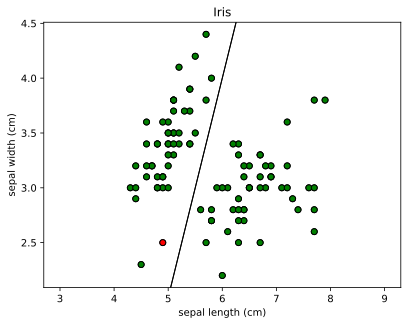

In [3]:
plot_iris_seperation(a=2, b=-8).savefig("assignment2-1.png")
plot_iris_seperation(a=2, b=-8).show()

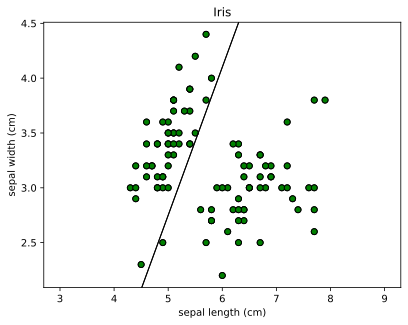

In [4]:
plot_iris_seperation(a=1.35, b=-4).savefig("assignment2-2.png")
plot_iris_seperation(a=1.35, b=-4).show()

# Excercise 2

In [5]:
def regular_polygon_vertices(K, d):
    R = d / (2 * math.sin(math.pi / K))
    vertices = []
    for i in range(K):
        theta = 2 * math.pi * i / K
        x = R * math.cos(theta)
        y = R * math.sin(theta)
        vertices.append((x, y))
    return np.array(vertices)


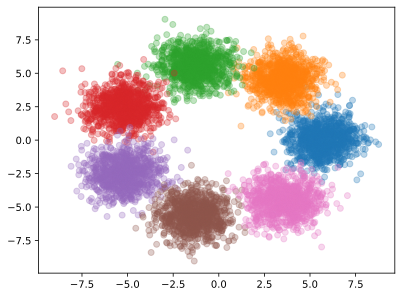

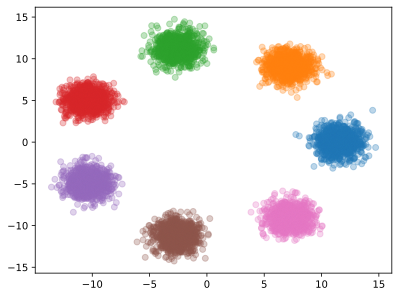

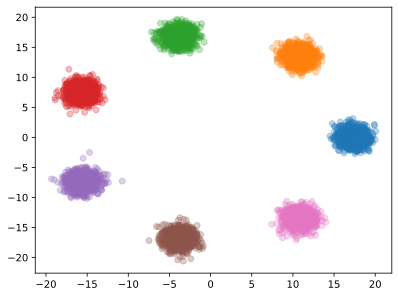

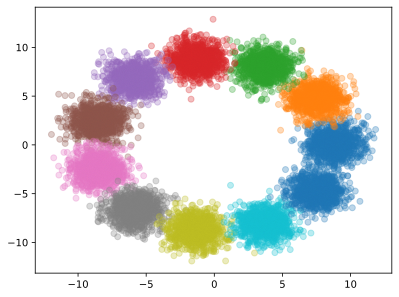

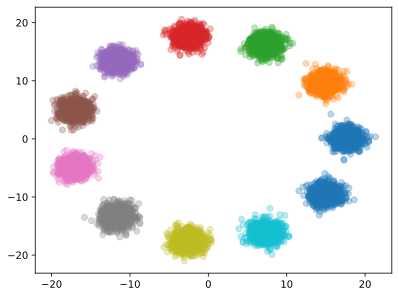

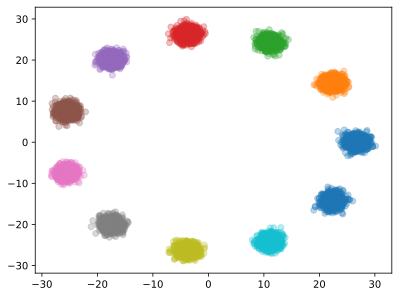

In [6]:
for K, d in product([7, 11, 23], [5, 10, 15]):
    for vertex in regular_polygon_vertices(K, d):
        plt.scatter(*np.random.multivariate_normal(vertex, np.diag([1, 1]), 10**3).T, alpha=0.3)
    plt.savefig(f"assignment2-2:{K}:{d}.png")
    plt.show()

# Excercise 3

In [7]:
def distance(X, Y):
	squared_diffs = (X[:, None, :] - Y[None, :, :]) ** 2
	return np.sqrt(np.sum(squared_diffs, axis=-1))

In [8]:
def overlap(K, d, n=10**3):
	polygon_vertices = regular_polygon_vertices(K, d)
	clouds = np.array([
		np.random.multivariate_normal(v, np.diag([1, 1]), n)
		for v in polygon_vertices
	])

	catclouds = np.concatenate(clouds)
	D = distance(catclouds, polygon_vertices)
	C = np.argmin(D, axis=1)
	Z = catclouds[np.arange(len(catclouds)) // n != C]
	print("ratio:", len(Z)/len(catclouds))

	plt.scatter(*catclouds.T, color="darkgreen", alpha=0.2)
	plt.scatter(*Z.T, color="darkred")

In [14]:
overlap(20, 2*norm.ppf(0.95))

ratio: 0.09825


# Excersie 4

In [15]:
X, Y = np.random.random((10000, 100)), np.random.random((1000, 100))

In [16]:
distance(Y, Y)

array([[0.        , 4.34982718, 4.35669295, ..., 4.1346917 , 4.16711375,
        4.17819516],
       [4.34982718, 0.        , 4.13548467, ..., 4.36998254, 4.0255022 ,
        4.4006823 ],
       [4.35669295, 4.13548467, 0.        , ..., 4.1232791 , 4.18014956,
        4.17477456],
       ...,
       [4.1346917 , 4.36998254, 4.1232791 , ..., 0.        , 3.4652469 ,
        4.30832784],
       [4.16711375, 4.0255022 , 4.18014956, ..., 3.4652469 , 0.        ,
        4.2590881 ],
       [4.17819516, 4.4006823 , 4.17477456, ..., 4.30832784, 4.2590881 ,
        0.        ]])

In [18]:
def batched_distance(X, Y, batchsize = 1000):
	return np.concatenate([
		distance(X[i*batchsize : (i+1)*batchsize], Y)
		for i in range(len(X) // batchsize)
	])

In [20]:
batched_distance(X, Y)

array([[4.17451162, 4.12295579, 3.96351111, ..., 4.35512792, 4.17933492,
        4.38510217],
       [4.06024335, 4.16474565, 4.04764455, ..., 3.88142793, 3.97215506,
        4.54149305],
       [4.05948423, 4.4475049 , 4.17401259, ..., 4.13055567, 4.3421103 ,
        4.17374198],
       ...,
       [3.86719275, 3.77848743, 4.08151267, ..., 4.33363606, 4.16400007,
        4.26463918],
       [4.73102117, 3.77105378, 4.22217641, ..., 4.28929858, 4.24848192,
        4.3156453 ],
       [3.95612109, 3.90863785, 3.76869644, ..., 4.19136828, 4.07721304,
        4.02663825]])

# Excercise 5

In [37]:
def knearest(X, Y, k=None):
	D = batched_distance(X, Y)
	return np.argsort(D, axis=1)[:, :k or len(Y)]

In [40]:
# 1-nearest
knearest(X, Y, k=1)

array([[220],
       [504],
       [932],
       ...,
       [441],
       [225],
       [946]])

In [41]:
# 10-nearest
knearest(X, Y, k=10)

array([[220, 633, 727, ..., 386, 769, 562],
       [504, 160, 412, ..., 402, 957, 333],
       [932, 602, 945, ..., 376, 335, 499],
       ...,
       [441, 386, 787, ..., 234, 402, 362],
       [225, 608, 555, ..., 247, 614, 983],
       [946, 861, 575, ..., 855, 232, 689]])